# Music Similarity Analysis

#### Research Question: How sensitive are state-of-the-art methods (OpenL3, AudioMAE) to different musical components (drums vs. vocals vs. melody)?

Dataset: MUSDB18 - 150 full-track music files (stereo, 44.1kHz Sample Rate) with separated sources (vocals, drums, bass, other)  Link: https://zenodo.org/records/1117372

Models: OpenL3 (audio-visual correspondence) and AudioMAE (masked autoencoder)

## Layout of this notebook

Data manipulation & Statistics of the dataset

Experiment 1 Cross-Component Similarity Analysis

Experiment 2

Experiment 3


# Intro For Implementation & Configuration

#### This Markdown cell serves the function as README.md file.

#### This notebook uses functions from utils.py just like what we did in our homeworks. This notebook only delivers experiment process and visualized results. Some testing cells are marked with "TEST" text, we use these sections to test our functions and implementations from imported libraries; while others are of the parts of the experiment, for which we think can help understand the development of this research project.

#### All used libraries are included in the requirement.txt file, to install all dependencies into Python environment, run: pip install -r requirements.txt




In [6]:

%pip install --upgrade pip setuptools wheel

%pip install -r requirements.txt


Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


#### Dependencies

In [ ]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import musdb
import importlib
import utils_exp02 as u
from IPython.display import Audio, display


importlib.reload(u)


from numpy.random import seed
seed(123)

# Data Manipulation

#### Constant Variables

In [8]:
MUSDB_ROUTE = "./musdb18"
SAMPLE_RATE = 44100
DURATION = 30.0 # 30 seconds
MAX_TRACKS = 20

#### Data Processing

In [9]:
train_tracks = u.load_musdb_tracks(
    MUSDB_ROUTE, 
    subset='train', 
    max_tracks=5
)

Loaded track 1: A Classic Education - NightOwl
Loaded track 2: ANiMAL - Clinic A
Loaded track 3: ANiMAL - Easy Tiger
Loaded track 4: ANiMAL - Rockshow
Loaded track 5: Actions - Devil's Words


In [10]:
test_tracks = u.load_musdb_tracks(
    MUSDB_ROUTE, 
    subset='test', 
    max_tracks=5
)

Loaded track 1: AM Contra - Heart Peripheral
Loaded track 2: Al James - Schoolboy Facination
Loaded track 3: Angels In Amplifiers - I'm Alright
Loaded track 4: Arise - Run Run Run
Loaded track 5: BKS - Bulldozer


In [11]:
for component in ['mixture', 'vocals', 'drums', 'bass', 'other']:
    print(f"Playing component: {component}")
    display(u.play_audio(train_tracks[0][component], sample_rate=SAMPLE_RATE))


Playing component: mixture


Playing component: vocals


Playing component: drums


Playing component: bass


Playing component: other


##### TEST

In [12]:
segment = u.extract_audio_segment_from_track(train_tracks[0], 'mixture', start_time=10.0, end_time=15.0, sample_rate=SAMPLE_RATE)
print(f"Segment shape: {segment.shape}")
display(u.play_audio(segment, sample_rate=SAMPLE_RATE))


Segment shape: (220500, 2)


In [13]:
mono = u.extract_mono_audio(train_tracks[0], 'mixture')
print(f"Original: {train_tracks[0]['mixture'].shape}, Mono: {mono.shape}")
display(u.play_audio(mono, sample_rate=44100))


Original: (7552000, 2), Mono: (7552000,)


In [14]:
mus = musdb.DB(root=MUSDB_ROUTE, subsets="train")

In [15]:
mono_mixture = u.extract_mono_audio(train_tracks[0], 'mixture')
print(f"Original: {train_tracks[0]['mixture'].shape}, Mono: {mono_mixture.shape}")
display(u.play_audio(train_tracks[0]['mixture'], sample_rate=44100))
display(u.play_audio(mono_mixture, sample_rate=44100))


Original: (7552000, 2), Mono: (7552000,)


In [16]:
print(mus)
type(mus)
len(mus)
mus.tracks[0]
mus.tracks[0].audio


array([[0.01473999, 0.00299072],
       [0.03262329, 0.01638794],
       [0.05395508, 0.03790283],
       ...,
       [0.        , 0.        ],
       [0.        , 0.        ],
       [0.        , 0.        ]], shape=(7552000, 2))

In [17]:
train_tracks[0]['mixture'].shape

(7552000, 2)

In [18]:
type(train_tracks[0]['mixture'])

numpy.ndarray

In [19]:
type(u.extract_component_audio(train_tracks[0], 'mixture'))

numpy.ndarray

In [20]:
u.extract_component_audio(train_tracks[0], 'mixture').shape

(7552000, 2)

# Experiment 2: Solo Component vs Mixture Similarity Analysis

#### Research Question: How sensitive are OpenL3 and AudioMAE to drums vs vocals? Which solo component (vocals or drums) is more similar to the full mixture?

**Objective:** Test which solo component (drums or vocals) is more similar to the full mixture

**Methodology:**
- For each track, extract ~10-second segments (ensuring both vocals and drums are present)
- Compute Sim(vocal(solo), Mixture) 
- Compute Sim(Drum(solo), Mixture)
- Compare these two similarities

**Conclusion Criteria:**
- Sim(vocal(solo), Mixture) > Sim(Drum(solo), Mixture) → Model is more sensitive to vocals
- Sim(vocal(solo), Mixture) < Sim(Drum(solo), Mixture) → Model is more sensitive to drums

**Data Preprocessing:**
- Use the full MusDB18 training set (~5GB)
- Each experimental segment is ~10 seconds
- Ensure segments contain both vocals and drums (via RMS energy detection)



### Load full training dataset for Experiment 2

In [ ]:
importlib.reload(u)

# Load full training dataset for Experiment 2
print("Loading full training dataset for Experiment 2...")
experiment2_tracks = u.load_musdb_tracks(
    MUSDB_ROUTE, 
    subset='train', 
    max_tracks=None  # None to load all tracks
)
print(f"\nLoaded {len(experiment2_tracks)} tracks for Experiment 2")


Loading full training dataset for Experiment 2...
Loaded track 1: A Classic Education - NightOwl
Loaded track 2: ANiMAL - Clinic A
Loaded track 3: ANiMAL - Easy Tiger
Loaded track 4: ANiMAL - Rockshow
Loaded track 5: Actions - Devil's Words
Loaded track 6: Actions - One Minute Smile
Loaded track 7: Actions - South Of The Water
Loaded track 8: Aimee Norwich - Child
Loaded track 9: Alexander Ross - Goodbye Bolero
Loaded track 10: Alexander Ross - Velvet Curtain
Loaded track 11: Angela Thomas Wade - Milk Cow Blues
Loaded track 12: Atlantis Bound - It Was My Fault For Waiting
Loaded track 13: Auctioneer - Our Future Faces
Loaded track 14: AvaLuna - Waterduct
Loaded track 15: BigTroubles - Phantom
Loaded track 16: Bill Chudziak - Children Of No-one
Loaded track 17: Black Bloc - If You Want Success
Loaded track 18: Celestial Shore - Die For Us
Loaded track 19: Chris Durban - Celebrate
Loaded track 20: Clara Berry And Wooldog - Air Traffic
Loaded track 21: Clara Berry And Wooldog - Stella
Loa


### Test finding valid segments for the first track

In [ ]:
# Test finding valid segments for the first track
# and verify that segments contain both vocals and drums
test_track = experiment2_tracks[0]
print(f"Testing segment finding for track: {test_track['name']}")

valid_segments = u.find_valid_segments(
    test_track, 
    segment_duration=10.0, 
    sample_rate=SAMPLE_RATE,
    step_size=5.0
)

print(f"\nFound {len(valid_segments)} valid segments:")
for i, (start, end) in enumerate(valid_segments[:5]):  # Show first 5
    print(f"  Segment {i+1}: {start:.1f}s - {end:.1f}s")



Testing segment finding for track: A Classic Education - NightOwl

Found 28 valid segments:
  Segment 1: 0.0s - 10.0s
  Segment 2: 5.0s - 15.0s
  Segment 3: 10.0s - 20.0s
  Segment 4: 15.0s - 25.0s
  Segment 5: 20.0s - 30.0s


#### Manual Verification of Segments

**Purpose:** Manually verify that the found segments actually contain both vocals and drums

**Usage:**
1. Select a track and segment
2. Play the three versions: mixture, vocals, and drums
3. Judge the segment quality by listening


In [ ]:
importlib.reload(u)

# Select a track for verification
verify_track_idx = 0 
verify_track = experiment2_tracks[verify_track_idx]

print(f"Verifying Track: {verify_track['name']}")
print("=" * 60)

# Find all valid segments for this track
valid_segments = u.find_valid_segments(
    verify_track, 
    segment_duration=10.0, 
    sample_rate=SAMPLE_RATE,
    step_size=5.0
)

print(f"Found {len(valid_segments)} valid segments")
print(f"Time ranges of first 10 segments:")
for i, (start, end) in enumerate(valid_segments[:10]):
    print(f"  {i+1}. {start:.1f}s - {end:.1f}s")


Verifying Track: A Classic Education - NightOwl
Found 28 valid segments
Time ranges of first 10 segments:
  1. 0.0s - 10.0s
  2. 5.0s - 15.0s
  3. 10.0s - 20.0s
  4. 15.0s - 25.0s
  5. 20.0s - 30.0s
  6. 25.0s - 35.0s
  7. 30.0s - 40.0s
  8. 35.0s - 45.0s
  9. 40.0s - 50.0s
  10. 45.0s - 55.0s



### Verify a segment

In [ ]:
importlib.reload(u)

# Select the segment to verify
segment_idx = 0 

if segment_idx < len(valid_segments):
    start_time, end_time = valid_segments[segment_idx]
    
    # Display and play the segment
    seg_info = u.display_segment_for_verification(
        verify_track, 
        start_time, 
        end_time, 
        sample_rate=SAMPLE_RATE
    )


Segment: 0.0s - 10.0s (10.0s)
Vocal RMS:  0.0328
Drum RMS:   0.0174
Mixture RMS: 0.1453

Playing Mixture (Full Mix):



Playing Vocal (Vocals Only):



Playing Drum (Drums Only):



## Experiment 2 with OpenL3

In [25]:
importlib.reload(u)

print("=" * 60)
print("Running Experiment 2 with OpenL3")
print("=" * 60)
print("Note: Using RMS energy normalization for vocal and drum segments")
print("      to eliminate volume level effects (target RMS = 0.1)")
print("=" * 60)

openl3_exp2_results = u.run_experiment2(
    experiment2_tracks,
    model_type='openl3',
    segment_duration=10.0,
    sample_rate=SAMPLE_RATE,
    max_segments_per_track=3,  # Use up to 3 segments per track
    normalize_rms=True,  # Enable RMS normalization for vocal and drum
    target_rms=0.1  # Target RMS energy level
)

print("\n" + "=" * 60)
print("OpenL3 Experiment 2 Results Summary")
print("=" * 60)
print(f"Total segments analyzed: {openl3_exp2_results['stats']['num_segments']}")
print(f"Mean Vocal (solo) vs Mixture similarity: {openl3_exp2_results['stats']['mean_vocal_sim']:.4f} ± {openl3_exp2_results['stats']['std_vocal_sim']:.4f}")
print(f"Mean Drum (solo) vs Mixture similarity: {openl3_exp2_results['stats']['mean_drum_sim']:.4f} ± {openl3_exp2_results['stats']['std_drum_sim']:.4f}")
print(f"Median Vocal similarity: {openl3_exp2_results['stats']['median_vocal_sim']:.4f}")
print(f"Median Drum similarity: {openl3_exp2_results['stats']['median_drum_sim']:.4f}")

# Determine sensitivity
if openl3_exp2_results['stats']['mean_vocal_sim'] > openl3_exp2_results['stats']['mean_drum_sim']:
    print(f"\n✓ OpenL3 is more sensitive to VOCALS (vocal similarity is higher)")
else:
    print(f"\n✓ OpenL3 is more sensitive to DRUMS (drum similarity is higher)")


Running Experiment 2 with OpenL3
Note: Using RMS energy normalization for vocal and drum segments
      to eliminate volume level effects (target RMS = 0.1)

Processing track: A Classic Education - NightOwl
  Found 28 valid segments, using 3
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step
    Segment [0.0s-10.0s]: Vocal sim=0.9703, Drum sim=0.9663
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step
    Segment [5.0s-15.0s]: Vocal sim=0.9690, Drum sim=0.9641
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step
    Segment [10.0s-20.0s]: Vocal sim=0.9689, Drum sim=0.9627

Processing track: ANiMAL - Clinic A
  Found 42 valid segments, using 3
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step
    Segment [0.0s-10.0s]: Vocal sim=0.7417, Drum sim=0.7300
3/3 ━━━━━━━━━


## Experiment 2 with AudioMAE

In [ ]:
importlib.reload(u)

# Load AudioMAE model
if 'feature_extractor' not in locals() or 'model' not in locals():
    AUDIOMAE_MODEL_NAME = "MIT/ast-finetuned-audioset-10-10-0.4593"
    feature_extractor, model = u.load_audiomae_model(model_name=AUDIOMAE_MODEL_NAME)
    print("AudioMAE model loaded")

print("=" * 60)
print("Running Experiment 2 with AudioMAE")
print("=" * 60)
print("Note: Using RMS energy normalization for vocal and drum segments")
print("      to eliminate volume level effects (target RMS = 0.1)")
print("=" * 60)

audiomae_exp2_results = u.run_experiment2(
    experiment2_tracks,
    model_type='audiomae',
    feature_extractor=feature_extractor,
    model=model,
    segment_duration=10.0,
    sample_rate=SAMPLE_RATE,
    max_segments_per_track=3,  # Use up to 3 segments per track
    normalize_rms=True,  # Enable RMS normalization for vocal and drum
    target_rms=0.1  # Target RMS energy level
)

print("\n" + "=" * 60)
print("AudioMAE Experiment 2 Results Summary")
print("=" * 60)
print(f"Total segments analyzed: {audiomae_exp2_results['stats']['num_segments']}")
print(f"Mean Vocal (solo) vs Mixture similarity: {audiomae_exp2_results['stats']['mean_vocal_sim']:.4f} ± {audiomae_exp2_results['stats']['std_vocal_sim']:.4f}")
print(f"Mean Drum (solo) vs Mixture similarity: {audiomae_exp2_results['stats']['mean_drum_sim']:.4f} ± {audiomae_exp2_results['stats']['std_drum_sim']:.4f}")
print(f"Median Vocal similarity: {audiomae_exp2_results['stats']['median_vocal_sim']:.4f}")
print(f"Median Drum similarity: {audiomae_exp2_results['stats']['median_drum_sim']:.4f}")

# Determine sensitivity
if audiomae_exp2_results['stats']['mean_vocal_sim'] > audiomae_exp2_results['stats']['mean_drum_sim']:
    print(f"\n✓ AudioMAE is more sensitive to VOCALS (vocal similarity is higher)")
else:
    print(f"\n✓ AudioMAE is more sensitive to DRUMS (drum similarity is higher)")


AudioMAE model loaded
Running Experiment 2 with AudioMAE
Note: Using RMS energy normalization for vocal and drum segments
      to eliminate volume level effects (target RMS = 0.1)

Processing track: A Classic Education - NightOwl
  Found 28 valid segments, using 3
    Segment [0.0s-10.0s]: Vocal sim=0.8790, Drum sim=0.8447
    Segment [5.0s-15.0s]: Vocal sim=0.8673, Drum sim=0.8361
    Segment [10.0s-20.0s]: Vocal sim=0.8771, Drum sim=0.8397

Processing track: ANiMAL - Clinic A
  Found 42 valid segments, using 3
    Segment [0.0s-10.0s]: Vocal sim=0.6617, Drum sim=0.6973
    Segment [5.0s-15.0s]: Vocal sim=0.8410, Drum sim=0.7985
    Segment [10.0s-20.0s]: Vocal sim=0.9167, Drum sim=0.8418

Processing track: ANiMAL - Easy Tiger
  Found 39 valid segments, using 3
    Segment [5.0s-15.0s]: Vocal sim=0.8520, Drum sim=0.9523
    Segment [10.0s-20.0s]: Vocal sim=0.8471, Drum sim=0.9274
    Segment [15.0s-25.0s]: Vocal sim=0.8517, Drum sim=0.9171

Processing track: ANiMAL - Rockshow
  Found


## MODEL COMPARISON SUMMARY


MODEL COMPARISON SUMMARY
Total Segments Analyzed: OpenL3=295, AudioMAE=295

VOCAL (Solo) vs Mixture Similarity:
  OpenL3:  0.9530 ± 0.0486
  AudioMAE: 0.8416 ± 0.0797
  Difference (OpenL3 - AudioMAE): +0.1114

DRUM (Solo) vs Mixture Similarity:
  OpenL3:  0.9534 ± 0.0345
  AudioMAE: 0.8487 ± 0.0504
  Difference (OpenL3 - AudioMAE): +0.1047

MODEL SENSITIVITY:
  OpenL3:  More sensitive to DRUMS (drum: 0.9534 > vocal: 0.9530)
  AudioMAE: More sensitive to DRUMS (drum: 0.8487 > vocal: 0.8416)

COMPARISON:
  OpenL3 shows HIGHER vocal similarity by 0.1114



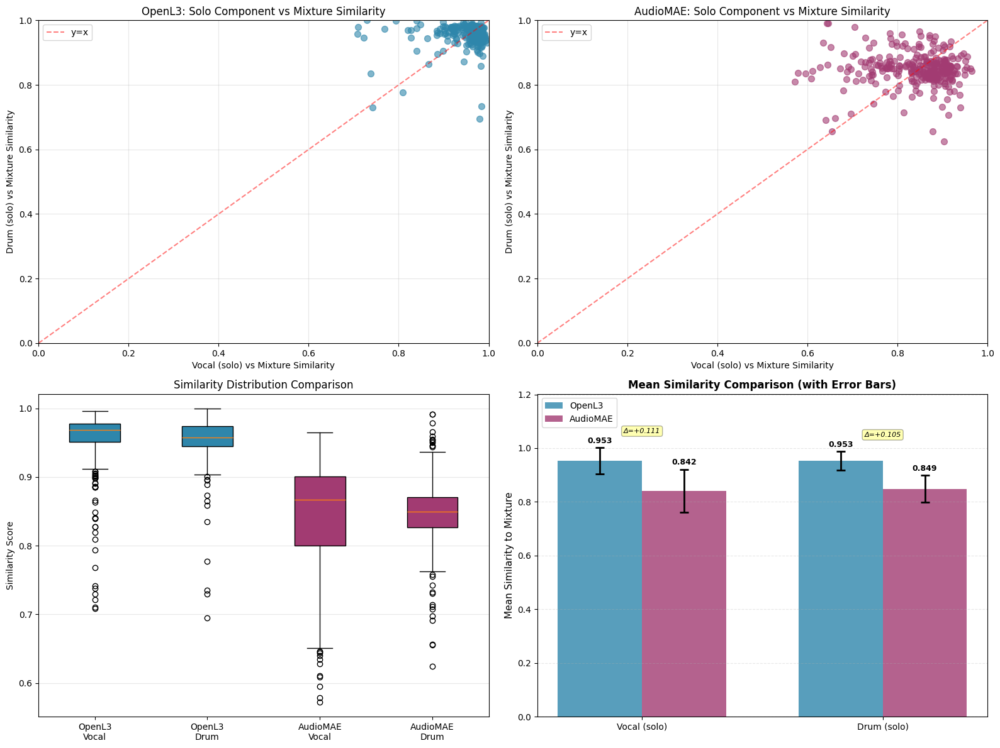

In [30]:
importlib.reload(u)

fig = u.plot_experiment2_results(openl3_exp2_results, audiomae_exp2_results, figsize=(16, 12))
plt.show()
